In [2]:
import pandas as pd

#matplotlib is a python library for basic graph plotting
import matplotlib.pyplot as plt

#seaborn is another python graphing library that is built upon matplotlib and allows you to optimize matplotlib's output
import seaborn as sns

#switching from matplotlib's default graphing style to that of seaborn's. Seaborn displays graph lines, matplotlib doesn't
sns.set(color_codes = True)

#removing warnings from the output
import warnings
warnings.filterwarnings("ignore")

In [3]:
cancer = pd.read_csv('https://raw.githubusercontent.com/nicolerodriguez16/breast-cancer-csv/main/data%202.csv')

In [39]:
cancer.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [ ]:
cancer.shape

(569, 33)

In [ ]:
cancer.columns #getting to know the data^^^^^

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],
      dtype='object')

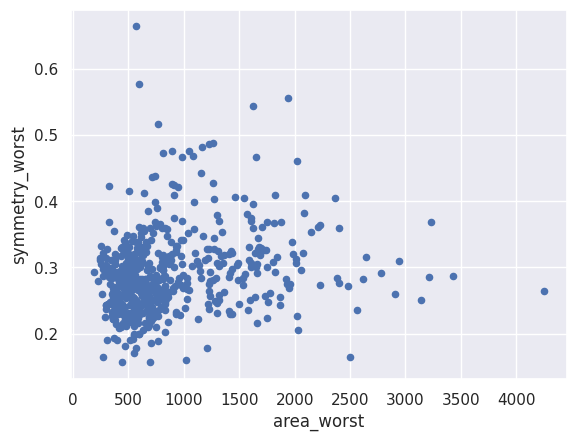

In [42]:
cancer.plot(kind='scatter', x = 'area_worst', y = 'symmetry_worst')
plt.show()

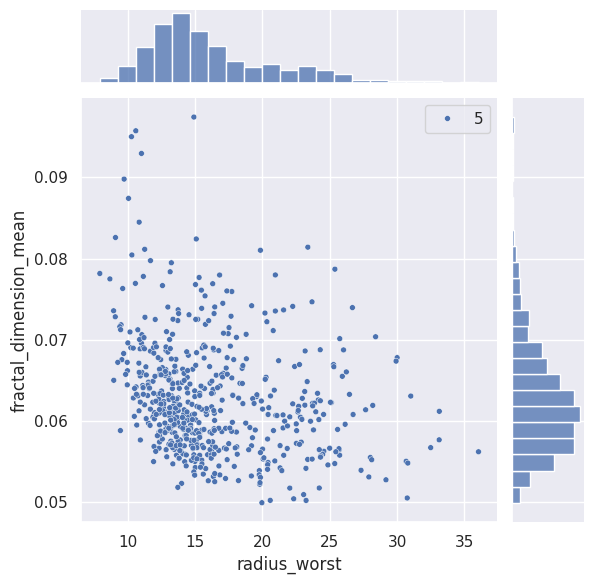

In [ ]:
sns.jointplot(x = 'radius_worst', y = 'fractal_dimension_mean', data = cancer, size =5)
plt.show()

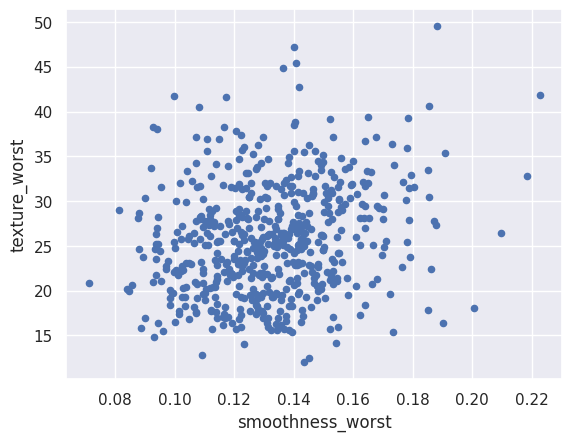

In [ ]:
cancer.plot(kind='scatter', x = 'smoothness_worst', y = 'texture_worst')
plt.show()

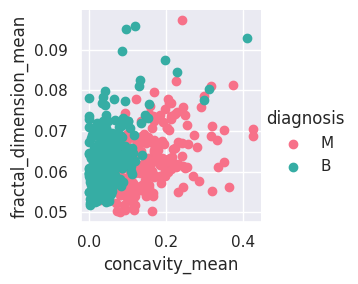

In [ ]:
sns.FacetGrid(cancer, hue='diagnosis', palette='husl').map(plt.scatter, 'concavity_mean', 'fractal_dimension_mean').add_legend()
plt.show()

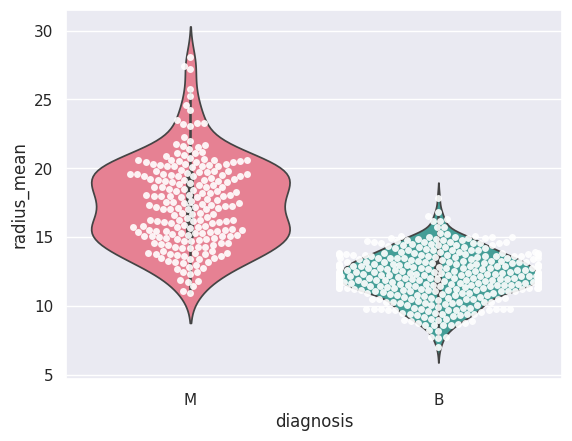

In [ ]:
#plotting a violin plot
sns.violinplot(x= 'diagnosis', y='radius_mean', palette='husl', data=cancer)

#plotting a swarm plot on top of the violin plot
sns.swarmplot(x='diagnosis', y='radius_mean', data=cancer, color='w', alpha=.9);
plt.show()

In [ ]:
sns.pairplot(cancer, hue='diagnosis', palette='husl')
plt.show() #saved the image to my desktop to view the output

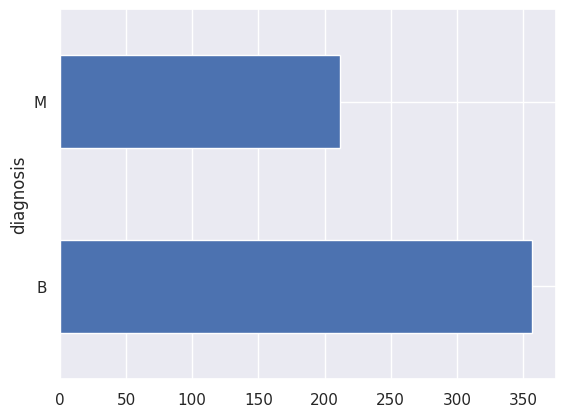

In [ ]:
cancer["diagnosis"].value_counts().plot.barh();

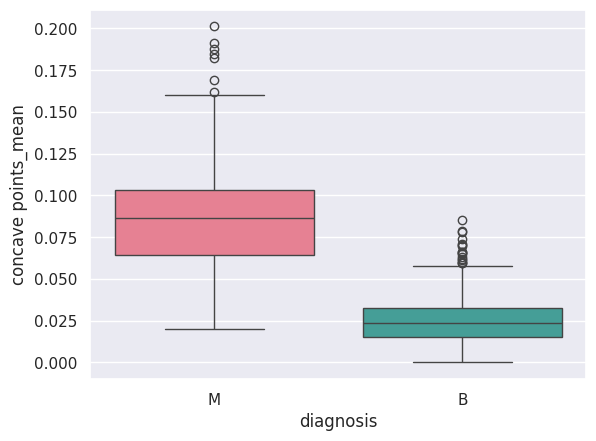

In [ ]:
sns.boxplot(x="diagnosis", y ="concave points_mean", palette='husl', data = cancer)
plt.show()

<Axes: xlabel='diagnosis', ylabel='compactness_mean'>

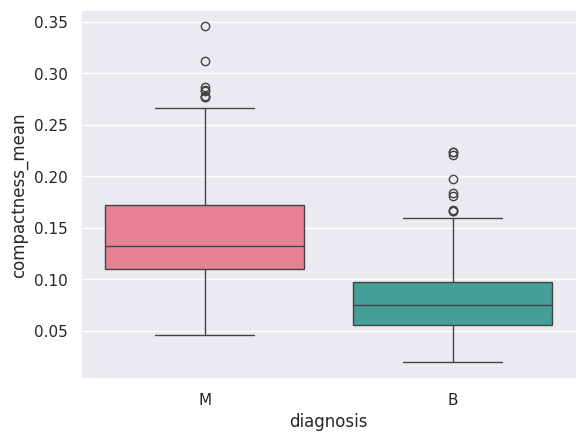

In [ ]:
sns.boxplot(x="diagnosis", y ="compactness_mean", palette='husl', data = cancer)

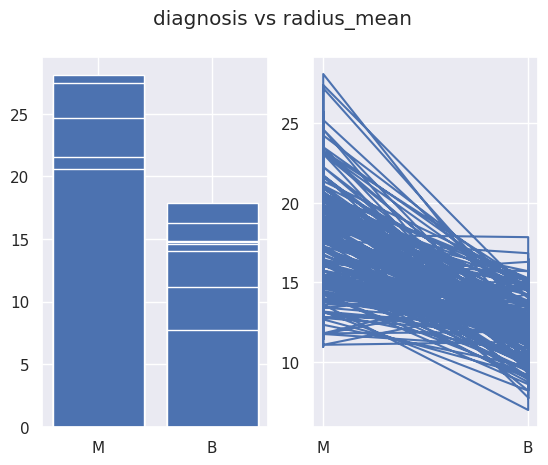

<Figure size 5000x100000 with 0 Axes>

In [4]:
#Creating subplots

#our data
diagnoisis = cancer['diagnosis']
radius_mean = cancer['radius_mean']

#creating the layout for our subplots - one row with 2 figures
figure, axes = plt.subplots(nrows=1, ncols=2)

plt.figure(figsize=(50,1000))

#We have create a one dimensional array of plots
#Index 0 will have the bar plot
axes[0].bar(diagnoisis, radius_mean)

#index 1 will have the line plot
axes[1].plot(diagnoisis, radius_mean)
figure.suptitle('diagnosis vs radius_mean')
plt.show()

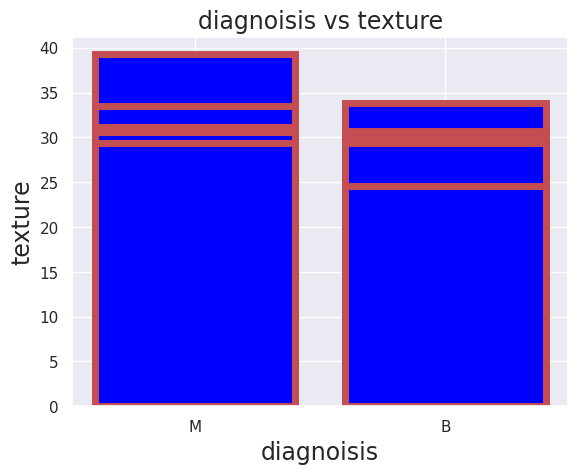

In [ ]:
#Bar Graphs
#our data
diagnoisis = cancer['diagnosis']
texture = cancer['texture_mean']

# the edgecolor and linewidth parameter values
plt.bar(diagnoisis, texture, color = 'blue', edgecolor='r', linewidth=5)
plt.title('diagnoisis vs texture',fontsize=17)
plt.xlabel('diagnoisis',fontsize=17)
plt.ylabel('texture',fontsize=17)
plt.show()

In [ ]:
cancer['diagnosis'] = cancer['diagnosis'].map({0: 'B', 1: 'M'})#Adding a number to the diagnosis to be able to make correlation matrix

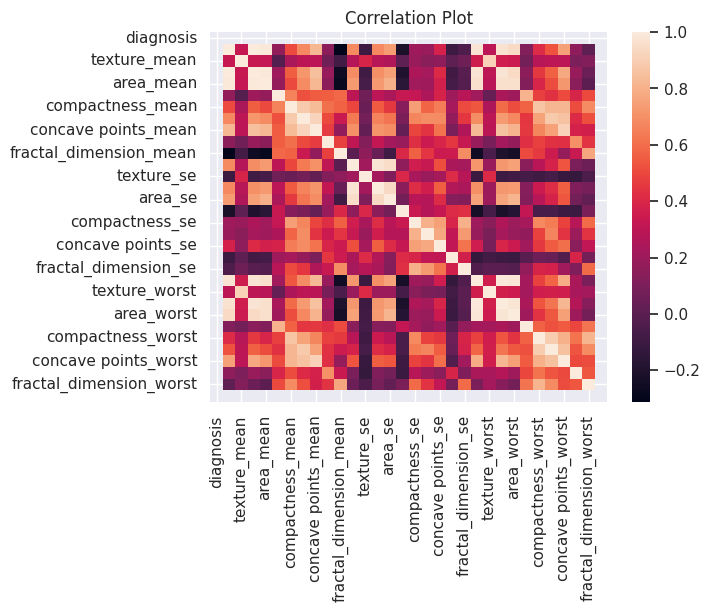

In [ ]:
corr_matrix = cancer.iloc[:, 1:].corr()#to exclude the name as an attribite bc its a string
sns.heatmap(corr_matrix)
plt.title('Correlation Plot')
plt.show() #Visual 1